<center>
<h1>Mejor Ubicación Hospital</h1>
    <h3>Manuel Arias  &nbsp;  &nbsp; Lina Prado</h3>
    <h3>Jeisson Prieto  &nbsp;  &nbsp; Cristian Pulido </h3>
    <h3>Julián Torres</h3>
</center>


In [9]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [10]:
import numpy as np
import scipy
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy.stats import multivariate_normal
import matplotlib.colors as mcolors
from scipy import integrate
from scipy.optimize import minimize
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.figure_factory as ff
init_notebook_mode(connected=True)
from scipy.optimize import curve_fit
from plotly import tools

In [11]:
# np.inf distancia del maximo
def norma(x,orden=2):
    return np.linalg.norm(x,axis=1,ord=orden)

<center>
<h2>Registros Distancia vs. Tiempo</h2>  

<table style="border-collapse:collapse;border-spacing:0" class="tg"><tr><th style="font-family:Arial, sans-serif;font-size:14px;font-weight:bold;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">Distancia (Kms)</th><th style="font-family:Arial, sans-serif;font-size:14px;font-weight:bold;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">Tiempo</th><th style="font-family:Arial, sans-serif;font-size:14px;font-weight:bold;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">-<br></th><th style="font-family:Arial, sans-serif;font-size:14px;font-weight:bold;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">Distancia (Kms)</th><th style="font-family:Arial, sans-serif;font-size:14px;font-weight:bold;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">Tiempo</th></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">1.22</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">2.62</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.19</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.26</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">3.48</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">8.35</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|<br></td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.11</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">7.00</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">5.10</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">6.52</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.09</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">5.49</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">3.39</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">3.51</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|<br></td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.96</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">7.64</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">4.13</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">6.52</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">1.64</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.09</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">1.75</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">2.46</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.23</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.89</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">2.95</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">5.02</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.07</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">5.49</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">1.30</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">1.73</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.26</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">6.82</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">0.76</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center">1.14</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.40</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">5.53</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">2.52</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.56</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|<br></td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">2.42</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">4.30</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">1.66</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">2.90</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">|</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">2.96</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.55</td></tr><tr><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">1.84</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top">3.19</td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top"></td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top"></td><td style="font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;text-align:center;vertical-align:top"></td></tr></table>



</center>

In [12]:
registros=[[1.22, 2.62],[3.19, 4.26],[3.48,8.35],[4.11,7.00],[5.10,6.52],[3.09,5.49],[3.39,3.51],[4.96,7.64],[4.13,6.52],[1.64,3.09],[1.75,2.46],[3.23,3.89],[2.95,5.02],[3.07,5.49],[1.30,1.73],[4.26,6.82],[0.76,1.14],[4.40,5.53],[2.52,4.56],[2.42,4.30],[1.66,2.90],[2.96,3.55],[1.84,3.19],[0,0]]
registros=pd.DataFrame(registros,columns=['Distancia','Tiempo']).sort_values('Distancia').reset_index(drop=True)

In [13]:
trace = go.Scatter(
    x = registros.Distancia[1:],
    y = registros.Tiempo[1:],
    mode = 'markers',
    name = 'Registros'
    
)
point = go.Scatter(
    x = [0],
    y = [0],
    mode = 'markers',
    name = 'Origen'
)
layout = go.Layout(
    title='Registros Distancia Vs. Tiempo',
    font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'),
    xaxis=dict(
        title='Distancia',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Tiempo',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)


data = [trace,point]
fig = go.Figure(data=data, layout=layout)
# Plot and embed in ipython notebook!
iplot(fig)

## Hipótesis
<ul>
    <li>La velocidad de una ambulancia es independiente del lugar de la ciudad por donde transite.</li>
   
</ul>


<h2> Aproximación de la función tiempo de llegada de una ambulancia$:= t(x)$</h2>
<ul>
    <li> Interpolación splines cúbicos </li>
    <li> Ajuste Lineal</li>
    <li> Ajuste Cuadratico</li>
    <li> Ajuste Cúbico</li>
</ul>



In [14]:
xs = np.sort(list(np.arange(0, max(registros.Distancia), 0.1))+list(registros.Distancia))
for i in xs:
    registros=registros.append({'Distancia':i},ignore_index=True)
registros=registros.drop_duplicates('Distancia').sort_values('Distancia').reset_index(drop=True)
originales=registros[['Distancia','Tiempo']].dropna()

In [15]:
cubic_spline=scipy.interpolate.CubicSpline(originales.Distancia, originales.Tiempo, axis=0, bc_type='not-a-knot', extrapolate=None)

In [16]:
registros['Spline']=cubic_spline(registros.Distancia)
registros['Spline_error']=abs(registros.Tiempo-registros.Spline)

In [17]:
def polinomio_ajuste(x,y,grado):
    
    columns=grado#+1
    filas = len(x)
    
    matriz=np.ones((filas,columns))
    
    for i in range(columns):
        matriz[:,i]=np.power(x,i+1)
        #matriz[:,i]=np.power(x,i) para considerar coeficiente independiente
        #matriz[:,i]=np.power(x,i+1) para no considerar coeficiente independiente
    
    y=np.array(y).reshape((len(y),1))
    
    coef=np.dot(np.dot(np.linalg.inv(np.dot(matriz.T,matriz)),matriz.T),y)
    
    y_approx=np.dot(matriz,coef)
    
    return coef, y_approx

def evaluar_polinomio(x,coeficientes):
    return np.dot(np.array([np.power(x,len(coeficientes)-i) for i in range(len(coeficientes))]).T,coeficientes).flatten()
    #len(coeficientes)-1-i para considerar coeficiente independiente
    #len(coeficientes)-i para no considerar coeficiente independiente
    

In [18]:
polinomios=[]
for i,j in zip([1,2,3],['Lineal','Cuadratico','Cúbico']):
    coef,t_approx=polinomio_ajuste(originales.Distancia,originales.Tiempo,i)
    polinomios.append(coef)
    registros[j]=evaluar_polinomio(registros.Distancia,coef)
    registros[j+'_error']=abs(registros[j]-registros.Tiempo)  


In [19]:
aproximaciones=[]
for i in ['Spline','Lineal','Cuadratico','Cúbico']:
    grafica=go.Scatter(
        x = registros.Distancia,
        y = registros[i],

        mode = 'lines',
        name = i,
        error_y=dict(
                type='data',
                array=registros[i+'_error'],
                visible=True
                )

    )
    
    
    aproximaciones.append(grafica)
data = data+aproximaciones
fig = go.Figure(data=data, layout=layout)
# Plot and embed in ipython notebook!
iplot(fig)

In [20]:
Errores=pd.DataFrame(registros[['Spline_error','Lineal_error','Cuadratico_error','Cúbico_error']].sum(),columns=['Error Estimación'])

trace = go.Bar(
    x=Errores['Error Estimación']+0.01,
    y=list(Errores.index),
    orientation='h',
    text=list(Errores.index),
    textposition = 'auto',
    marker=dict(
        color='rgb(158,202,225)',
        line=dict(
            color='rgb(8,48,107)',
            width=1),
    ),   
)
layout = go.Layout(
    title='Errores de Estimación',
    font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'),
    xaxis=dict(
        title='Error',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
            )
        ),
    yaxis=dict(
        autorange=True,
        showgrid=False,
        zeroline=False,
        showline=False,
        ticks='',
        showticklabels=False
    )
    )



data = [trace]
fig = go.Figure(data=data, layout=layout)
# Plot and embed in ipython notebook!
iplot(fig)

In [21]:
soluciones={}
grado_funcion=Errores.reset_index(drop=True)[1:].idxmin().values[0]
distance_order=2 #np.inf 

<h2> Escogemos la función lineal por que... </h2>
<ul>
<li>Es la que menor error de estimación posee</li>
<li>Es capaz de generalizar a puntos que no se tomaron en cuenta</li>
</ul>
<center>$$t(x)=1.538x$$</center>

In [22]:
def t(emergencia,hospital,coeficientes=polinomios[grado_funcion-1],distance_order=2):
    return evaluar_polinomio(norma(np.array(emergencia)-np.array(hospital),distance_order),coeficientes)

In [23]:
frequency = np.array([[ 0,2,3,1,1,1], 
                      [10,6,3,1,3,1],
                      [ 8,5,2,1,0,0],
                      [ 5,3,3,0,1,2],
                      [ 2,1,1,2,3,2],
                      [ 3,0,1,4,2,1]])

In [24]:

means=[]
for row in range(6):
    for col in range(6):
        means.append([col+0.5,  row+0.5])
means=np.array(means)
def discreto(hospital,frequency=frequency,coeficientes=polinomios[grado_funcion-1],distance_order=2):
    return sum(t(means,hospital,coeficientes,distance_order)*frequency.flatten())

## Frecuencia Llamadas en la ciudad

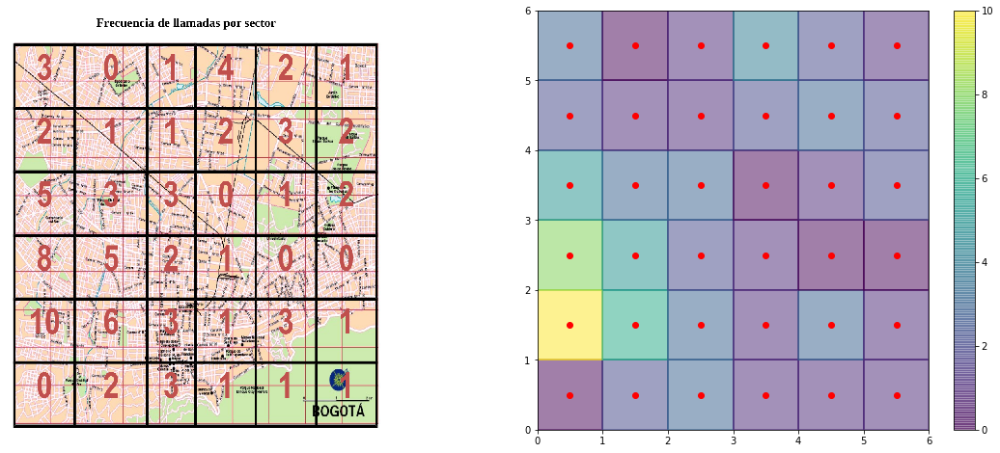

In [25]:
X,Y=np.meshgrid(np.arange(7),np.arange(7))

fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,8))
ax1.imshow(plt.imread("img.png"))
ax1.axis('off')
im=ax2.pcolormesh(X,Y,frequency,cmap='viridis',edgecolors='face',alpha=0.5,snap=True)
ax2.scatter(means[:,0],means[:,1],c='r')
fig.colorbar(im, ax=ax2)
plt.show()

# Modelo Discreto

## Hipótesis
<ul>
    <li>Que  la  ambulancia  llegue  al  centro  de  la  cuadricula  donde  se  produjo  una  emergencia
implica que dicha emergencia ha sido atendida.</li>
    <li>El hospital puede ser ubicado en cualquier parte de la ciudad.</li>
    <li>Las llamadas de emergencia son independientes entre si</li>
    <li>Todas las llamadas de una cuadrícula suceden en el centro de esta</li>
</ul>

### Sean $f(x_i,y_i)$ la función que retorna la frecuencia de llamadas del punto central de una región y $d((x_1,y_1),(x_2,y_2))$ la función que retorna la distancia entre dos puntos, la función a optimizar se define como:
$$ H((x_{0},y_{0}))=\sum_{i=1}^{36}f(x_i,y_i) t\left( d((x_0,y_0),(x_i,y_i)) \right)$$
### Donde $(x_{0},y_{0})$ es la posición del hospital

<center><h2>Metodos de optimización basados en Simplex</h2></center>

![SegmentLocal](Nelder_Mead2.gif "segment")

In [26]:
step=0.025
X, Y = np.meshgrid(np.arange(0, 6., step), np.arange(0, 6., step))
points=[i for i in zip(X.flatten(),Y.flatten())]

In [27]:
def c1(x):
    return x[0]
def c2(x):
    return x[1]
def c3(x):
    return 6- x[0]
def c4(x):
    return 6- x[1]
cons = [{'type':'ineq', 'fun': c1},
        {'type':'ineq', 'fun': c2},
        {'type':'ineq', 'fun': c3},
        {'type':'ineq', 'fun': c4}]


In [28]:
metodos=['Nelder-Mead','Powell','COBYLA']
def discreto(hospital,frequency=frequency,coeficientes=polinomios[grado_funcion-1],distance_order=2):
    return sum(t(means,hospital,coeficientes,distance_order)*frequency.flatten())

In [29]:
time_metodos=[]
for i in metodos:
    a=%timeit -o minimize(discreto, [2,2], method = i,args=(frequency,polinomios[grado_funcion-1],distance_order),tol=1e-10)
    time_metodos.append([a.average,a.stdev])    
time_metodos=np.array(time_metodos)

9.01 ms ± 702 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
14.1 ms ± 1.69 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)
3.64 ms ± 382 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [30]:
data = [
    go.Bar( x=time_metodos[:,0],  y=metodos, 
               orientation='h' ,
               text=metodos,
               textposition = 'auto',
               marker=dict(
                   color='rgb(158,202,225)',
                   line=dict(
                       color='rgb(8,48,107)',
                       width=1),
                ),
          )
]
layout = go.Layout(
    title='Tiempos Convergencia Métodos Optimización',
    font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'),
    xaxis=dict(
        title='Tiempo (segundos)',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        autorange=True,
        showgrid=False,
        zeroline=False,
        showline=False,
        ticks='',
        showticklabels=False
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)



In [31]:
sol_d=minimize(discreto, [2,2], method = 'COBYLA',args=(frequency,polinomios[grado_funcion-1],distance_order),tol=1e-10)
soluciones['Discreto']=sol_d.x
print("Salida Optimización")
print(sol_d)

Salida Optimización
     fun: 267.35897621146563
   maxcv: 0.0
 message: 'Optimization terminated successfully.'
    nfev: 84
  status: 1
 success: True
       x: array([1.6962646 , 2.57368759])


In [32]:
h_disc=[discreto(i,frequency=frequency,coeficientes=polinomios[grado_funcion-1],distance_order=2) for i in points]
fig = tools.make_subplots(rows=1, cols=2,
                          specs=[[{'is_3d': False}, {'is_3d': True}]],print_grid=False)

# adding surfaces to subplots.
fig.append_trace(dict(type='contour', x=X[0], y=X[0], z=np.array(h_disc).reshape(X.shape), colorscale='Viridis',
                      showscale=True), 1, 1)

fig.append_trace(dict(type='scatter', x=[sol_d.x[0]], y=[sol_d.x[1]],mode = 'markers'), 1, 1)

fig.append_trace(dict(type='surface', x=X[0], y=X[0], z=np.array(h_disc).reshape(X.shape), colorscale='Viridis',
                       showscale=False), 1, 2)
fig['layout'].update(title='Evaluación H(x,y)',font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'))
iplot(fig)


# Modelo Continuo

## Hipótesis
<ul>
    <li>Las llamadas pueden surgir de cualquier punto de la ciudad y la ambulancia debe llegar al punto para atender la emergencia</li>
    <li>En cada casilla las llamadas se comportan siguiendo una distribución normal con media en el centro de la casilla. </li>
    <li>En las casillas donde la frecuenia de llamadas era cero aún tienen la posibilidad de ocurrencia de llamada.</li>
</ul>

Para un punto $p_c$ con componentes $(x_c, y_c)$ en la $k$-cuadricula la función de densidad de probabilidad (Relacionada entonces con la frecuencia) es:

\begin{equation}
    \phi_c(p|\mu_k, \Sigma_k) = \frac{exp(-\frac{1}{2}((p-\mu_k)^T\Sigma_k^{-1}(p-\mu_k)))}{\sqrt{(2\pi)^2 |\Sigma_k|}}
\end{equation}

donde

$${\mu }={\begin{pmatrix}\mu _{x}\\\mu _{y}\end{pmatrix}},\quad {\boldsymbol  \Sigma }={\begin{pmatrix}\sigma _{x}^{2}& 0\\0&\sigma _{y}^{2}\end{pmatrix}}.
$$
En nuestro modelo, asumimos que el $95\%$ de los datos se encuentran en la casilla, es decir $2\sigma = 0.5km$. 



Para extrapolar el método de esta casilla a las 36 casillas en el mapa, usamos las mezclas gaussianas. Donde la función de densidad de probabilidad para cada punto de la región $p$ con coordenadas $(x,y)$ esta dado por:

\begin{equation}
    \phi(x) =  \sum_{k=1}^{36} \pi_k \phi_k(p | \mu_k, \Sigma_k)    
\end{equation}

Los parametros $\pi_k$ son llamados coeficientes de mixtura, donde se sabe que:


$$ \sum_{k=1}^{36} \pi_k =1 ,\quad 0 \leq \pi_k \leq 1.
$$



Si normalizamos los valores de las frecuencias de llamadas por cuadricula, obtenemos los valores de $\pi_k$, es decir.

$$
\pi_k = \frac{f(x_i, y_y) }{ \sum_{k=1}^{36} f(x_i, y_y) }
$$

Donde la nueva función a optimizar seria:

$$\underset{(x_0, y_0) \in A}{\text{minimizar}} \iint{\phi(x,y) t\left( d((x_0,y_0),(x,y)) \right) dA}$$

In [33]:
pi=frequency.flatten()/frequency.sum()
def fdp(x):
    return 8/np.pi*sum(pi*np.exp(-8*np.sum(np.power(means-x,2),axis=1)))

In [34]:
step=0.025
X, Y = np.meshgrid(np.arange(0, 6., step), np.arange(0, 6., step))
points=[i for i in zip(X.flatten(),Y.flatten())]

In [35]:
fdp_values=np.array([fdp(i) for i in points])

In [36]:
# Centro de masa
cm=sum([i*j for i,j in zip(fdp_values,np.array(points))])/sum(fdp_values)
soluciones['Centro Masa']=cm

In [37]:
Z=fdp_values.reshape(X.shape)
fig = tools.make_subplots(rows=1, cols=2,
                          specs=[[{'is_3d': False}, {'is_3d': True}]],print_grid=False)

# adding surfaces to subplots.
fig.append_trace(dict(type='contour', x=X[0], y=X[0], z=Z, colorscale='Viridis',
                      showscale=True), 1, 1)

fig.append_trace(dict(type='surface', x=X[0], y=X[0], z=Z, colorscale='Viridis',
                       showscale=False), 1, 2)
fig['layout'].update(title='Densidad Probabilidad Llamadas y Curvas de nivel',font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'))

iplot(fig)

In [38]:
def parameters(hospital=[3,3],coeficientes=polinomios[grado_funcion-1],distance_order=distance_order):

    def integrando(y,x,hospital=hospital,coeficientes=coeficientes,distance_order=distance_order):
        return (fdp([x,y])*t([[x,y]],hospital,coeficientes=coeficientes,distance_order=distance_order))[0]
    
    return integrando
def integrar(x,coeficientes=polinomios[grado_funcion-1],distance_order=2):
    return integrate.dblquad(parameters(hospital=x,coeficientes=coeficientes,distance_order=distance_order), 0, 6, 0, 6)[0]

In [39]:
sol=minimize(integrar, [2,2],method = 'COBYLA',args=(polinomios[grado_funcion-1],distance_order),constraints=cons,tol=1e-10)
soluciones['Continuo']=sol.x
sol

     fun: 3.152371731279606
   maxcv: 0.0
 message: 'Optimization terminated successfully.'
    nfev: 76
  status: 1
 success: True
       x: array([1.7887034 , 2.60870059])

In [40]:
"""
step=0.1
X, Y = np.meshgrid(np.arange(0, 6., step), np.arange(0, 6., step))
points=[i for i in zip(X.flatten(),Y.flatten())]

h_con=[integrar(i,coeficientes=polinomios[grado_funcion-1],distance_order=distance_order) for i in points]
fig = tools.make_subplots(rows=1, cols=2,
                          specs=[[{'is_3d': False}, {'is_3d': True}]],print_grid=False)

# adding surfaces to subplots.
fig.append_trace(dict(type='contour', x=X[0], y=X[0], z=np.array(h_con).reshape(X.shape), colorscale='Viridis',
                      showscale=True), 1, 1)

fig.append_trace(dict(type='scatter', x=[sol.x[0]], y=[sol.x[1]],mode = 'markers'), 1, 1)

fig.append_trace(dict(type='surface', x=X[0], y=X[0], z=np.array(h_con).reshape(X.shape), colorscale='Viridis',
                       showscale=False), 1, 2)
fig['layout'].update(title='Evaluación H(x,y) continuo')
iplot(fig)
"""

"\nstep=0.1\nX, Y = np.meshgrid(np.arange(0, 6., step), np.arange(0, 6., step))\npoints=[i for i in zip(X.flatten(),Y.flatten())]\n\nh_con=[integrar(i,coeficientes=polinomios[grado_funcion-1],distance_order=distance_order) for i in points]\nfig = tools.make_subplots(rows=1, cols=2,\n                          specs=[[{'is_3d': False}, {'is_3d': True}]],print_grid=False)\n\n# adding surfaces to subplots.\nfig.append_trace(dict(type='contour', x=X[0], y=X[0], z=np.array(h_con).reshape(X.shape), colorscale='Viridis',\n                      showscale=True), 1, 1)\n\nfig.append_trace(dict(type='scatter', x=[sol.x[0]], y=[sol.x[1]],mode = 'markers'), 1, 1)\n\nfig.append_trace(dict(type='surface', x=X[0], y=X[0], z=np.array(h_con).reshape(X.shape), colorscale='Viridis',\n                       showscale=False), 1, 2)\nfig['layout'].update(title='Evaluación H(x,y) continuo')\niplot(fig)\n"

In [41]:
Z=fdp_values.reshape(X.shape)


trace0 = go.Contour(
     x=X[0],
     y=X[0],
     z=Z,
     colorscale='Viridis',
     showscale=True
)

trace1 = go.Scatter(
      x=np.array(list(soluciones.values()))[:,0], 
      y=np.array(list(soluciones.values()))[:,1],
      mode="markers+text",
      text=list(soluciones.keys()),
      textposition=["bottom left","middle center","middle right"],
      marker = dict(
                            
                    size = 10,
                    color = np.random.randn(500),
                    #colorscale='Viridis',
                    #showscale=True,  
                    line = dict(
                        width = 2,
                    )
))

data = [trace0,trace1]
layout = go.Layout(
    title='Soluciones Encontradas',
    font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'),
    xaxis=dict(
        title='X',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Y',
        autorange=True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)


# Plot and embed in ipython notebook!
fig = go.Figure(data=data, layout=layout)
iplot(fig)



In [42]:
step=0.025
X, Y = np.meshgrid(np.arange(0, 6., step), np.arange(0, 6., step))
points=[i for i in zip(X.flatten(),Y.flatten())]

In [43]:
n_puntos_prueba=10000
puntos_prueba_uniforme=[points[np.random.choice(len(points))] for i in range(n_puntos_prueba)]
index=np.random.choice(np.arange(len(points)), n_puntos_prueba, p=fdp_values/sum(fdp_values))
puntos_prueba_fdp=[points[i] for i in index]

In [44]:
uniforme=np.array([])
means_uniforme={}
for h in soluciones:
    arreglo=np.array(t(puntos_prueba_uniforme,soluciones[h],coeficientes=polinomios[grado_funcion-1],distance_order=distance_order))
    means_uniforme[h]=np.mean(arreglo)
    uniforme=np.concatenate((uniforme,arreglo),axis=0)
fdp_sample=np.array([])
means_fdp={}
for h in soluciones:
    arreglo=np.array(t(puntos_prueba_fdp,soluciones[h],coeficientes=polinomios[grado_funcion-1],distance_order=distance_order))
    means_fdp[h]=np.mean(arreglo)
    fdp_sample=np.concatenate((fdp_sample,arreglo),axis=0)

In [45]:
annotations=[
        dict(
            x=-0.2+j*1,
            y=means_uniforme[i],
            xref='x',
            yref='y',
            text=format(means_uniforme[i], '.4f'),
            showarrow=True,
            #arrowhead=7,
            ax=-60,
            ay=0
        ) for i,j in zip(means_uniforme,np.arange(3)) 
    ]
annotations+=[
        dict(
            x=0.2+j*1,
            y=means_fdp[i],
            xref='x',
            yref='y',
            text=format(means_fdp[i], '.4f'),
            showarrow=True,
            #arrowhead=7,
            ax=60,
            ay=0
        ) for i,j in zip(means_fdp,np.arange(3)) 
    ]

In [46]:
fig = {
    "data": [
        {
            "type": 'violin',
            "x": np.array([[i]*10000 for i in list(soluciones.keys())]).flatten(),
            "y": uniforme,
            "legendgroup": 'Muestreo Uniforme',
            "scalegroup": 'Muestreo Uniforme',
            "name": 'Muestreo Uniforme',
            "box": {
                "visible": False
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": np.array([[i]*10000 for i in list(soluciones.keys())]).flatten(),
            "y": fdp_sample,
            "legendgroup": 'Muestreo fdp',
            "scalegroup": 'Muestreo fdp',
            "name": 'Muestreo fdp',
            "box": {
                "visible": False
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'red'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "autorange":True,
            "zeroline": False,
        },
        "violinmode": "group",
        "title":'Evaluación rendimiento modelos',
        "font":dict(family='Courier New, monospace', size=18, color='#7f7f7f'),
        "annotations":annotations
        
               
    }
}

iplot(fig)


<h2>Ventajas y Desventajas</h2>
<ul>
<li>Una ventaja del modelo discreto es que resuelve el problema con un costo computacional menor que el continuo con resultados similares.</li> 
<li>Con este modelo es posible aumentar la tasa de exito en la atención de las llamadas.</li>
    
    
<li>Es posible mejorar la solución teniedo datos reales.</li>
<li>Hace falta considerar factores como trafico en la ciudad, estado de las vias, reglas de transito y distribución de las vias entre otros factores que afecta el tiempo de llegada de las ambulancias.</li>
</ul>


In [47]:
distance_order=np.inf
s=minimize(discreto, [2,2], method = 'COBYLA',args=(frequency,polinomios[grado_funcion-1],distance_order),tol=1e-10)
h_disc=[discreto(i,frequency=frequency,coeficientes=polinomios[grado_funcion-1],distance_order=distance_order) for i in points]
fig = tools.make_subplots(rows=1, cols=2,
                          specs=[[{'is_3d': False}, {'is_3d': True}]],print_grid=False)

# adding surfaces to subplots.
fig.append_trace(dict(type='contour', x=X[0], y=X[0], z=np.array(h_disc).reshape(X.shape), colorscale='Viridis',
                      showscale=True), 1, 1)

fig.append_trace(dict(type='scatter', x=[s.x[0]], y=[s.x[1]],mode = 'markers'), 1, 1)

fig.append_trace(dict(type='surface', x=X[0], y=X[0], z=np.array(h_disc).reshape(X.shape), colorscale='Viridis',
                       showscale=False), 1, 2)
fig['layout'].update(title='Evaluación H(x,y)',font=dict(family='Courier New, monospace', size=18, color='#7f7f7f'))
iplot(fig)